In [1]:
import random
import os
import numpy as np
import mxnet as mx

def seed_everything():
    random.seed(42)
    np.random.seed(42)
    mx.random.seed(42)
    
seed_everything()

from _datasets import get_dataset
from _evaluator import IntermittentEvaluator
from gluonts.model.r_forecast import RForecastPredictor
from gluonts.model.prophet import ProphetPredictor
from gluonts.trainer import Trainer
from gluonts.evaluation.backtest import make_evaluation_predictions 
import mxnet as mx
import ast
from tqdm import tqdm
from argparse import ArgumentParser
from gluonts.model.forecast import SampleForecast
from croston import croston
from fbprophet import Prophet
from pathlib import Path
from gluonts.model.predictor import Predictor
import pandas as pd
import cufflinks as cf
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Config

In [2]:
parser = ArgumentParser()
parser.add_argument("-f", "--fff", help="a dummy argument to fool ipython", default="1")

# add PROGRAM level args
parser.add_argument('--datasource', type=str, default="retail_dataset")

args = parser.parse_args()
is_gpu = mx.context.num_gpus()>0

# Read in the dataset

## EDA

In [5]:
df = pd.read_pickle("tmp/temp.pkl")

combination = ["StockCode", "Country"]
split="2011-11-01"
idx = pd.IndexSlice[:, :, :split]
train_df = df.loc[idx, :].reset_index()
idx = pd.IndexSlice[:, :, split:]
test_df = df.loc[idx, :].reset_index()
full_df = df.reset_index()

train_df['key'] = train_df.StockCode.astype(str)+"|"+train_df.Country.astype(str)

In [6]:
counts = train_df.reset_index().groupby(['StockCode',"Country"])['index'].count()

In [7]:
len(counts[counts>(39+13)])

3671

In [8]:
len(counts)

3809

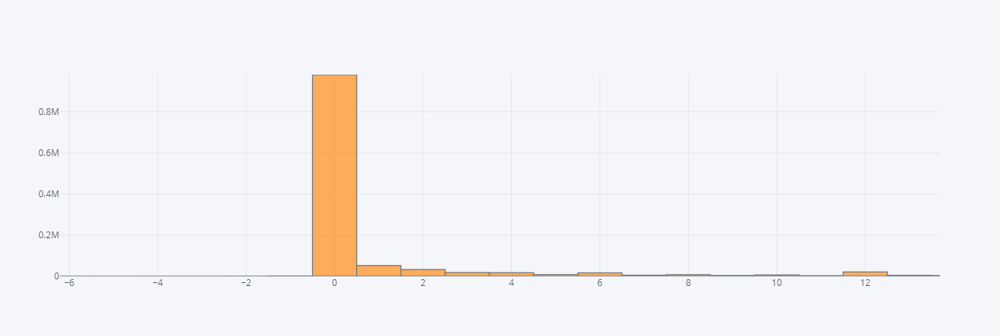

In [33]:
df.Quantity.iplot(kind='hist')

In [10]:
df.Quantity.mean(), df.Quantity.max(), df.Quantity.min(), df.Quantity.median()

(3.7620611561459465, 12540.0, 0.0, 0.0)

In [11]:
def calc_adi(x_in):
    """Calculate ADI for column whose value is greater than zero

    Args:
        x_in (array): Input Timeseries Array

    Returns:
        int: Average Demand Interval
    """
    # Adding one to the end to make sure the zeroes at the end is also considered
    x_in = x_in.tolist()
    x_in.append(1)
    data = pd.DataFrame(
        {"X": pd.Series(x_in)}, index=np.arange(0, len(x_in))
    ).reset_index()
    data = data[data.X > 0]
    data["index_shift"] = data["index"].shift(-1)
    data["interval"] = data["index_shift"] - data["index"]
    data = data.dropna(subset=["interval"])
    return np.mean(data["interval"])

def calc_cov(x_in):
    """Calculate covariance if series has more than 2 values and
    sum greater than zero to avoid division by zero

    Args:
        x_in (array): Input Timeseries Array

    Returns:
        int: Coefficient of Variation
    """
    if (len(x_in) > 2) and (x_in.sum() > 0):
        cov = np.std(x_in) / np.mean(x_in)
    else:
        cov = np.nan
    return cov

def get_classification(stat_df):
        """Segmentation using heuristics

        Args:
            ts_stats (TimeSeriesStats): TimeSeriesStats object with all the statistics of the timeseries

        Returns:
            str: Smooth, Erratic, Intermittent, or Lumpy
        """
        stat_df['classification'] = "NA"
        stat_df.loc[(stat_df.adi>1.32) &(stat_df.cov2>0.49),"classification"] = "Lumpy"
        stat_df.loc[(stat_df.adi>1.32) &(stat_df.cov2<=0.49),"classification"] = "Intermittent"
        stat_df.loc[(stat_df.adi<=1.32) &(stat_df.cov2>0.49),"classification"] = "Erratic"
        stat_df.loc[(stat_df.adi<=1.32) &(stat_df.cov2<=0.49),"classification"] = "Smooth"
        return stat_df

In [12]:
adi_df = train_df.groupby(combination)['Quantity'].apply(calc_adi)
# cov_df = train_df.groupby(combination)['Quantity'].apply(calc_cov)
_train_df = train_df[train_df.Quantity>0]
cov_df = _train_df.groupby(combination)['Quantity'].apply(calc_cov)

adi_df.name = "adi"
cov_df.name = "cov"

In [13]:
stat_df = adi_df.to_frame().join(cov_df.to_frame())
stat_df['cov2'] = np.power(stat_df['cov'],2)
stat_df = get_classification(stat_df)
stat_df['classification'] = stat_df['classification'].astype("category")
# stat_df

### Distribution

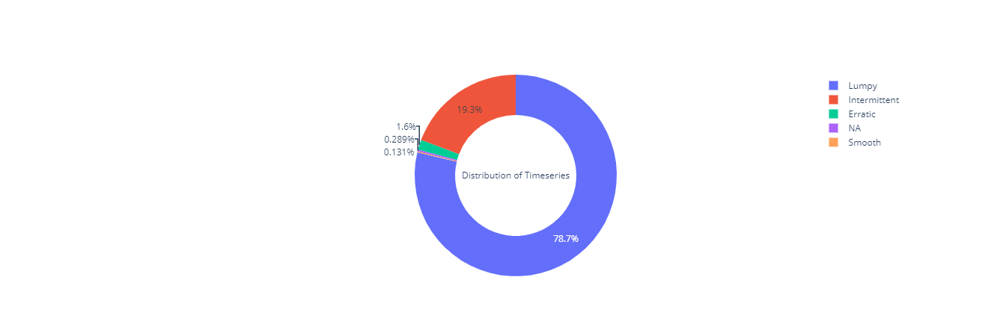

In [14]:
plot_df = stat_df.groupby("classification")['adi'].count().reset_index()

pie = go.Figure(data=[go.Pie(labels=plot_df.classification, values=plot_df.adi, hole=.6, title="Distribution of Timeseries")])
pie.show()

### Scatter Plot

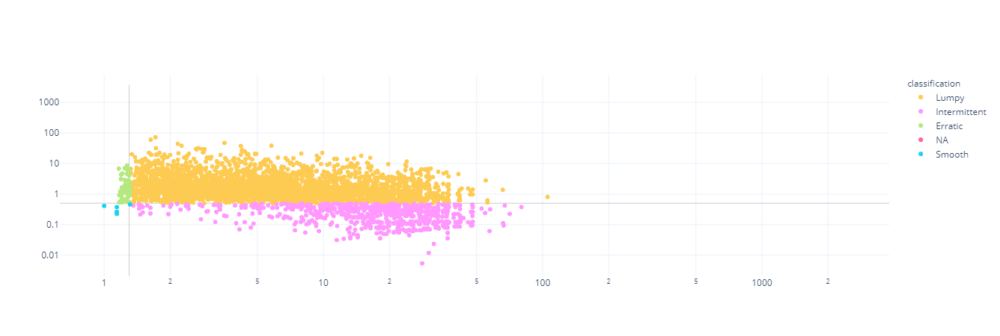

In [19]:
scatter = px.scatter(stat_df, x="adi", y="cov2", color="classification", log_x=True, log_y=True, color_discrete_sequence=px.colors.qualitative.Plotly[::-1],
                    template="plotly_white", title="<b>$ADI \;\;vs \;\;COV^2$")

scatter.add_trace(go.Scatter(x=[1.3]*len(stat_df), mode='lines', line_color='grey', opacity=0.4, showlegend=False, line=dict(width=1)))
scatter.add_trace(go.Scatter(y=[0.5]*len(stat_df), mode='lines', line_color='grey', opacity=0.4, showlegend=False, line=dict(width=1)))
scatter.update_xaxes(dict(title="<b>$ADI$</b>"))
scatter.update_yaxes(dict(title="<b>$COV^2$</b>"))
# scatter.update_layout(theme="plotly_white")
scatter

# Experiment

## Load Dataset

In [3]:
dataset = get_dataset(args.datasource, regenerate=False)

prediction_length = dataset.metadata.prediction_length
freq = dataset.metadata.freq
cardinality = ast.literal_eval(dataset.metadata.feat_static_cat[0].cardinality)
train_ds = dataset.train
test_ds = dataset.test

# Forecast Methods

## Zero Forecast

In [21]:
def generate_zero_forecast(train_ds, prediction_length, freq):
    for ts in iter(train_ds):
        target = ts['target']
        yhat = np.zeros(prediction_length)
        sample_fc = SampleForecast(samples=yhat.reshape(1, -1), 
                                   start_date=ts['start']+len(target)*pd.tseries.frequencies.to_offset(freq),
                                   freq = freq,
                                   item_id = ts['item_id'])
        yield sample_fc

zero_forecast = list(generate_zero_forecast(train_ds, 
                                             prediction_length, 
                                             freq))

## ETS

In [22]:
ets_predictor = RForecastPredictor(freq= freq, 
                                   prediction_length= prediction_length, 
                                   method_name = 'ets', 
                                   )

ets_forecast = list(ets_predictor.predict(train_ds))

## Arima

In [23]:
arima_predictor = RForecastPredictor(freq= freq, 
                                   prediction_length= prediction_length, 
                                   method_name = 'arima', 
                                   )

arima_forecast = list(arima_predictor.predict(train_ds))

## Croston

In [24]:
def generate_croston_forecast(train_ds, prediction_length, freq, **kwargs):
    croston_variant = kwargs.get("croston_variant", "original")
    number_parameters = kwargs.get("number_parameters",2)
    for ts in iter(train_ds):
        target = ts['target']
        fit_pred = croston.fit_croston(target, 
                                       forecast_length=prediction_length,
                                       croston_variant = croston_variant, 
                                       number_parameters=number_parameters)
        yhat = fit_pred['croston_forecast']
        sample_fc = SampleForecast(samples=yhat.reshape(1, -1), 
                                   start_date=ts['start']+len(target)*pd.tseries.frequencies.to_offset(freq),
                                   freq = freq,
                                   item_id = ts['item_id'])
        yield sample_fc

In [25]:
croston_forecast = list(generate_croston_forecast(train_ds, 
                                             prediction_length, 
                                             freq,
                                            croston_variant = "original",
                                            number_parameters = 2))

## Actuals

In [26]:
ets_forecast_it, ts_it = make_evaluation_predictions(
    dataset=test_ds, predictor=ets_predictor, num_samples=100
)
tss = list(tqdm(ts_it, total=len(test_ds)))

100%|████████████████████████████████████████████████████████████████████████████| 1822/1822 [00:00<00:00, 2179.04it/s]


In [2]:
import joblib

In [28]:
joblib.dump((tss, croston_forecast, arima_forecast, ets_forecast, zero_forecast),"tmp/fc_tss.sav")

['fc_tss.sav']

In [3]:
(tss, croston_forecast, arima_forecast, ets_forecast, zero_forecast) = joblib.load("tmp/fc_tss.sav")

# Evaluation

In [6]:
evaluator = IntermittentEvaluator(quantiles=[0.25,0.5,0.75], calculate_spec=True)
#Zero FC
print("Generating Zero forecasts.......")
zf_agg_metrics, zf_item_metrics = evaluator(
    iter(tss), iter(zero_forecast), num_series=len(test_ds)
)

print("Generating ETS forecasts.......")
ets_agg_metrics, ets_item_metrics = evaluator(
    iter(tss), iter(ets_forecast), num_series=len(test_ds)
)
#Croston
print("Generating Croston forecasts.......")
croston_agg_metrics, croston_item_metrics = evaluator(
    iter(tss), iter(croston_forecast), num_series=len(test_ds)
)
#Arima
print("Generating ARIMA forecasts.......")
arima_agg_metrics, arima_item_metrics = evaluator(
    iter(tss), iter(arima_forecast), num_series=len(test_ds)
)

croston_agg_metrics['method'] = "Croston"
arima_agg_metrics['method'] = "ARIMA"
ets_agg_metrics['method'] = "ETS"
zf_agg_metrics['method'] = "Zero Forecast"


Running evaluation:   0%|                                                                     | 0/1822 [00:00<?, ?it/s]

Generating Zero forecasts.......


Running evaluation: 100%|██████████████████████████████████████████████████████████| 1822/1822 [11:13<00:00,  2.70it/s]
D:\miniconda3\envs\timeseries\lib\site-packages\pandas\core\dtypes\cast.py:1507: UserWarning:


Running evaluation:   0%|                                                                     | 0/1822 [00:00<?, ?it/s]D:\Playground\ts_research\deep_renewal\deeprenewal\deeprenewal\_evaluator.py:166: RuntimeWarning:

divide by zero encountered in true_divide



Generating ETS forecasts.......


D:\Playground\ts_research\deep_renewal\deeprenewal\deeprenewal\_evaluator.py:209: RuntimeWarning:

divide by zero encountered in double_scalars

D:\Playground\ts_research\deep_renewal\deeprenewal\deeprenewal\_evaluator.py:211: RuntimeWarning:

divide by zero encountered in double_scalars

Running evaluation:   0%|                                                                     | 0/1822 [00:00<?, ?it/s]

Generating Croston forecasts.......


Running evaluation:   0%|                                                                     | 0/1822 [00:00<?, ?it/s]

Generating ARIMA forecasts.......


Running evaluation: 100%|██████████████████████████████████████████████████████████| 1822/1822 [11:08<00:00,  2.73it/s]


In [12]:
pd.set_option('display.max_columns', 500)

In [13]:
joblib.dump([zf_agg_metrics,croston_agg_metrics, 
                          arima_agg_metrics, 
                          ets_agg_metrics, 
                          ], "tmp/metrics.pkl")

['metrics.pkl']

In [14]:
joblib.dump([zf_item_metrics,croston_item_metrics, 
                          arima_item_metrics, 
                          ets_item_metrics, 
                          ], "tmp/item_metrics.pkl")

['item_metrics.pkl']

In [7]:
[zf_agg_metrics,croston_agg_metrics, 
                          arima_agg_metrics, 
                          ets_agg_metrics, 
                          ] = joblib.load("tmp/metrics.pkl")

In [8]:
[zf_item_metrics,croston_item_metrics, 
                          arima_item_metrics, 
                          ets_item_metrics, 
                          ] = joblib.load("tmp/item_metrics.pkl")

In [15]:
result_df = pd.DataFrame([zf_agg_metrics,
                          croston_agg_metrics, 
                          arima_agg_metrics, 
                          ets_agg_metrics, 
                          ])
result_df

,MSE,MAE,MRAE,MASE,MAPE,MAAPE,sMAPE,abs_target_sum,abs_target_mean,abs_error,seasonal_error,n,non_zero_n,CFE,PIS,QuantileLoss[0.25],Coverage[0.25],QuantileLoss[0.5],Coverage[0.5],QuantileLoss[0.75],Coverage[0.75],NOSp,PBMAE,SPEC_0.75,SPEC_0.5,SPEC_0.25,RMSE,CFE_min,CFE_max,RelMAE,RelRMSE,NRMSE,ND,wQuantileLoss[0.25],wQuantileLoss[0.5],wQuantileLoss[0.75],mean_wQuantileLoss,MAE_Coverage,method
0,1888.296054,10.775015,1.088684,0.853159,0.501632,0.785398,1.003265,765651.0,10.775015,765651.000000,483.796926,71058.0,35645.0,765651.000000,-1.551523e+07,382825.500000,0.000000,765651.000000,0.000000,1.148476e+06,0.000000,1.000000,0.284387,2264.202873,1509.468582,754.734291,43.454529,13657.000000,765651.000000,0.022272,0.167490,4.032897,1.000000,0.500000,1.000000,1.500000,1.000000,0.500000,Zero Forecast
1,1621.297347,11.144141,0.896252,1.400758,0.649216,0.634243,1.510919,765651.0,10.775015,791880.385754,483.796926,71058.0,35645.0,253966.906978,-5.281551e+06,664896.932264,0.633609,791880.385754,0.633609,9.188638e+05,0.633609,0.776799,0.486011,989.515364,784.425965,579.336567,40.265337,536.895051,258280.011928,0.023035,0.155198,3.736917,1.034258,0.868407,1.034258,1.200108,1.034258,0.211203,Croston
2,1538.575923,11.047915,1.430717,1.605892,0.756750,0.638544,1.446341,765651.0,10.775015,785042.717416,483.796926,71058.0,35645.0,187860.140164,-3.964842e+06,599513.061936,0.075882,785042.717416,0.659574,9.579060e+05,0.844958,0.649123,0.545737,589.803009,464.184191,338.565573,39.224685,-1720.360524,193935.434198,0.022836,0.151187,3.640337,1.025327,0.783011,1.025327,1.251100,1.019813,0.142883,ARIMA
3,1564.140461,11.211642,1.512197,1.592305,0.794353,0.640507,1.445026,765651.0,10.775015,796676.839947,483.796926,71058.0,35645.0,154912.084011,-3.387634e+06,620657.057568,0.088970,796676.839947,0.657660,9.580916e+05,0.847294,0.649460,0.546427,561.278740,455.792557,350.306416,39.549216,-2011.818872,162044.556790,0.023174,0.152438,3.670456,1.040522,0.810627,1.040522,1.251342,1.034164,0.138661,ETS


In [58]:
result_df[["method",'SPEC_0.75',"SPEC_0.5","SPEC_0.25","PIS"]]

,method,SPEC_0.75,SPEC_0.5,SPEC_0.25,PIS
0,Zero Forecast,2264.202873,1509.468582,754.734291,-1.551523e+07
1,Croston,989.515364,784.425965,579.336567,-5.281551e+06
2,ARIMA,589.803009,464.184191,338.565573,-3.964842e+06
3,ETS,561.278740,455.792557,350.306416,-3.387634e+06


In [60]:
result_df['PIS']/croston_item_metrics['n'].sum()

0   -218.346041
1    -74.327326
2    -55.797258
3    -47.674209
Name: PIS, dtype: float64

### Aggregate Rank Correlation

In [16]:
result_df = result_df[['method','MSE', 'MAE', 'MRAE', 'MASE', 'MAPE', 'MAAPE', 'sMAPE',
       'CFE', 'PIS', 'NOSp', 'PBMAE', 'RMSE', 'CFE_min', 'CFE_max',
       'RelMAE', 'RelRMSE', 'NRMSE', 'ND', 'SPEC_0.75',"SPEC_0.5","SPEC_0.25"]]

In [17]:
result_df

,method,MSE,MAE,MRAE,MASE,MAPE,MAAPE,sMAPE,CFE,PIS,NOSp,PBMAE,RMSE,CFE_min,CFE_max,RelMAE,RelRMSE,NRMSE,ND,SPEC_0.75,SPEC_0.5,SPEC_0.25
0,Zero Forecast,1888.296054,10.775015,1.088684,0.853159,0.501632,0.785398,1.003265,765651.000000,-1.551523e+07,1.000000,0.284387,43.454529,13657.000000,765651.000000,0.022272,0.167490,4.032897,1.000000,2264.202873,1509.468582,754.734291
1,Croston,1621.297347,11.144141,0.896252,1.400758,0.649216,0.634243,1.510919,253966.906978,-5.281551e+06,0.776799,0.486011,40.265337,536.895051,258280.011928,0.023035,0.155198,3.736917,1.034258,989.515364,784.425965,579.336567
2,ARIMA,1538.575923,11.047915,1.430717,1.605892,0.756750,0.638544,1.446341,187860.140164,-3.964842e+06,0.649123,0.545737,39.224685,-1720.360524,193935.434198,0.022836,0.151187,3.640337,1.025327,589.803009,464.184191,338.565573
3,ETS,1564.140461,11.211642,1.512197,1.592305,0.794353,0.640507,1.445026,154912.084011,-3.387634e+06,0.649460,0.546427,39.549216,-2011.818872,162044.556790,0.023174,0.152438,3.670456,1.040522,561.278740,455.792557,350.306416


In [18]:
rank_df = result_df.copy()

for col in ['MSE', 'MAE', 'MRAE', 'MASE', 'MAPE', 'MAAPE', 'sMAPE',
       'RMSE', 'NOSp',
       'RelMAE', 'RelRMSE', 'NRMSE', 'ND','SPEC_0.75',"SPEC_0.5","SPEC_0.25"]:
    rank_df[col] = rank_df[col].rank(ascending=True)

for col in ['PBMAE']:
    rank_df[col] = rank_df[col].rank(ascending=False)

for col in ['CFE', 'PIS', 'CFE_min', 'CFE_max']:
    rank_df[col] = np.abs(rank_df[col]).rank(ascending=True)

In [19]:
zero_metrics = (rank_df==1).iloc[0]
zero_metrics[zero_metrics]

MAE       True
MASE      True
MAPE      True
sMAPE     True
RelMAE    True
ND        True
Name: 0, dtype: bool

In [22]:
cols= ['MAE', 'MRAE', 'MASE', 'MAPE','RelMAE', "ND",'sMAPE', 'MSE', 'RMSE','CFE', 'PIS', "NOSp", 'PBMAE','CFE_max', 'SPEC_0.75',"SPEC_0.5","SPEC_0.25", 'RelRMSE', 'NRMSE', 'CFE_min', 'MAAPE']

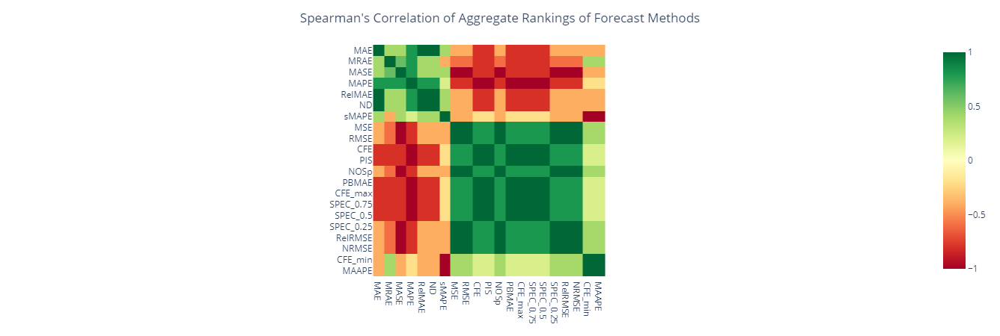

In [23]:
corr_df = rank_df[cols].corr(method='spearman')
fig = px.imshow(corr_df, template="plotly_white", color_continuous_scale="RdYlGn")
fig.update_layout(title_text="Spearman's Correlation of Aggregate Rankings of Forecast Methods", title_x=0.5)
fig.show()

## Rank Bump Chart

In [24]:
plot_df = pd.pivot_table(pd.melt(rank_df, id_vars = 'method', var_name="metric", value_name="Forecast Method"), index="metric", columns='method')
plot_df.reset_index(inplace=True)
plot_df.columns=['metric',"ARIMA","Croston","ETS","Zero Forecast"]

In [25]:
plot_df.head()

,metric,ARIMA,Croston,ETS,Zero Forecast
0,CFE,2.0,3.0,1.0,4.0
1,CFE_max,2.0,3.0,1.0,4.0
2,CFE_min,2.0,1.0,3.0,4.0
3,MAAPE,2.0,1.0,3.0,4.0
4,MAE,2.0,3.0,4.0,1.0


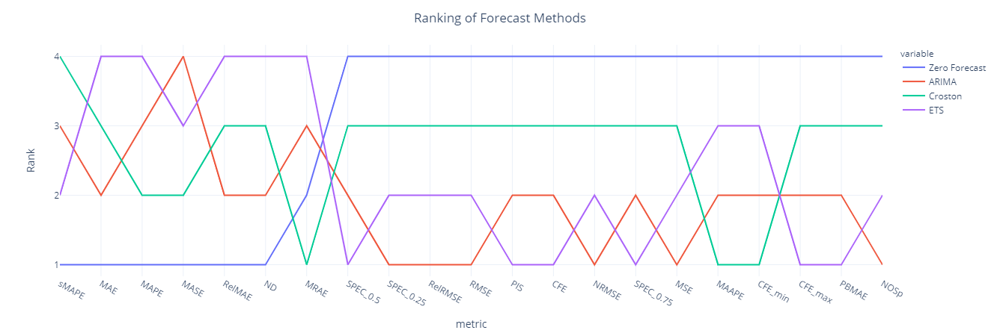

In [26]:
fig = px.line(plot_df.sort_values("Zero Forecast"), y=["Zero Forecast","ARIMA","Croston","ETS"], x='metric', template="plotly_white")
# fig.update_traces(line=dict(width=50))
fig.update_layout(title_text="Ranking of Forecast Methods", title_x=0.5,
                 yaxis = dict(
                    tickmode = 'linear',
                    tick0 = 0,
                    dtick = 1,
                     title="Rank"
                ))

In [27]:
plot_df = pd.melt(rank_df,id_vars = "method", var_name="Metric")
plot_df.head()

,method,Metric,value
0,Zero Forecast,MSE,4.0
1,Croston,MSE,3.0
2,ARIMA,MSE,1.0
3,ETS,MSE,2.0
4,Zero Forecast,MAE,1.0


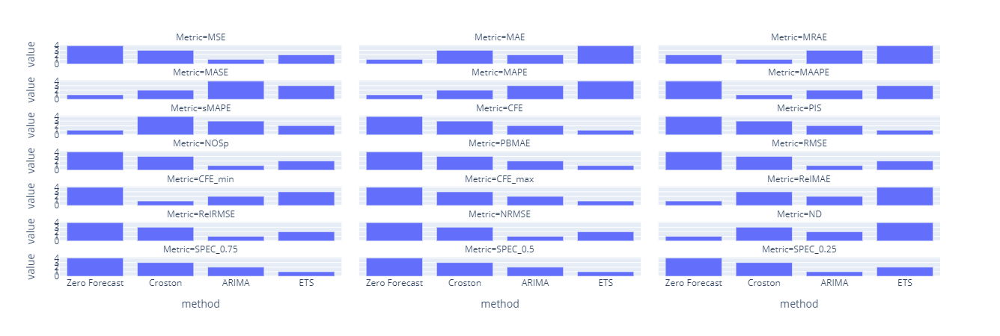

In [28]:
px.bar(plot_df, x="method", y="value", facet_col="Metric", facet_col_wrap=3, log_y=False)

### Item Ranking Correlation

In [29]:
croston_item_metrics['method'] = "Croston"
arima_item_metrics['method'] = "ARIMA"
ets_item_metrics['method'] = "ETS"
zf_item_metrics['method'] = "Zero Forecast"

item_metrics = pd.concat([croston_item_metrics, arima_item_metrics, ets_item_metrics, zf_item_metrics])

item_metrics = item_metrics[['CFE',
       'CFE_min', 'CFE_max', 'NOSp', 'PIS', 'MSE', 'RMSE', 'MAE', 'MRAE',
       'MASE', 'MAPE', 'RelMAE', 'RelRMSE', 'PBMAE', 'MAAPE', 'sMAPE','SPEC_0.75',"SPEC_0.5","SPEC_0.25",'method']]
item_metrics.head()

,CFE,CFE_min,CFE_max,NOSp,PIS,MSE,RMSE,MAE,MRAE,MASE,MAPE,RelMAE,RelRMSE,PBMAE,MAAPE,sMAPE,SPEC_0.75,SPEC_0.5,SPEC_0.25,method
0,-43.775072,-43.775072,-1.327566,0.000000,927.501444,2.243430,1.497808,1.396534,0.557478,6.808101,0.028589,6.808101,1.478967,0.948718,0.492993,1.940499,73.274056,146.548113,219.822169,Croston
1,-434.132868,-434.132868,-11.131612,NaN,8682.657360,123.912786,11.131612,11.131612,NaN,0.000000,0.000000,inf,inf,1.000000,NaN,2.000000,760.660153,1521.320307,2281.980460,Croston
2,189.588805,-1.877784,191.173995,0.894737,-3805.776110,126.838866,11.262276,6.247009,0.721802,0.848897,0.356213,0.848897,1.101509,0.333333,0.611269,1.633419,827.939258,552.007653,276.076049,Croston
3,86.073050,-0.792999,88.452046,1.000000,-2058.460992,48.306752,6.950306,3.183000,0.622484,0.756933,0.260265,0.756933,1.054580,0.307692,0.572174,1.670121,460.801431,307.207732,153.614032,Croston
4,338.413037,53.933668,411.408023,1.000000,-13282.260734,2595.690587,50.947920,17.032316,2.037244,1.155235,0.940266,1.155235,0.973706,0.743590,0.876597,1.627861,3727.880084,2485.253389,1242.626695,Croston


In [30]:
def calc_rank(rank_df):
    for col in ['MSE', 'MAE', 'MRAE', 'MASE', 'MAPE', 'MAAPE', 'sMAPE',
       'RMSE', 'NOSp',
       'RelMAE', 'RelRMSE', 'SPEC_0.75',"SPEC_0.5","SPEC_0.25"]:
        rank_df[col] = rank_df[col].rank(ascending=True)

    for col in ['PBMAE']:
        rank_df[col] = rank_df[col].rank(ascending=False)

    for col in ['CFE', 'PIS', 'CFE_min', 'CFE_max']:
        rank_df[col] = np.abs(rank_df[col]).rank(ascending=True)
    return rank_df

item_rankings =item_metrics.groupby('method').apply(calc_rank)

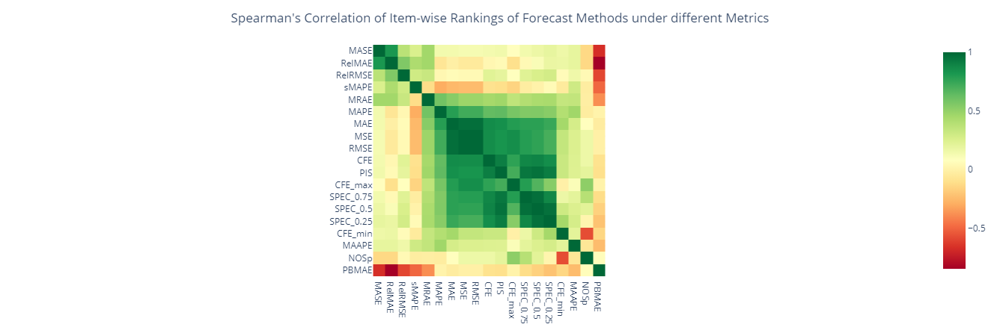

In [32]:
cols= ['MASE', 'RelMAE', 'RelRMSE', 'sMAPE','MRAE','MAPE', 'MAE', 'MSE', 'RMSE','CFE', 'PIS','CFE_max','SPEC_0.75',"SPEC_0.5","SPEC_0.25",'CFE_min', 'MAAPE', "NOSp", 'PBMAE']
corr_df = item_rankings[cols].corr(method='spearman')
fig = px.imshow(corr_df, template="plotly_white", color_continuous_scale="RdYlGn")
fig.update_layout(title_text="Spearman's Correlation of Item-wise Rankings of Forecast Methods under different Metrics", title_x=0.5)
fig.show()

### Loading Plot

In [33]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

In [34]:
def biplot(item_metrics_df, features, title="Loading Plot"):
    X = item_metrics_df[features].dropna()
    scaler = StandardScaler()
    scaler.fit(X)
    X=scaler.transform(X)
    pca = PCA(n_components=2, whiten=True)
    components = pca.fit_transform(X)
    loadings = pca.components_.T * np.sqrt(pca.explained_variance_)
    xs = components[:,0]
    ys = components[:,1]
    scalex = 1.0/(xs.max() - xs.min())
    scaley = 1.0/(ys.max() - ys.min())
    xl = loadings[:,0]
    yl = loadings[:,1]
    scalex_loading = 1.0/(xl.max() - xl.min())
    scaley_loading = 1.0/(yl.max() - yl.min())
    fig = px.scatter(x=xs * scalex, y=ys * scaley, opacity=0, template="plotly_white")
    for i, feature in enumerate(features):
        fig.add_shape(
            type='line',
            x0=0, y0=0,
            x1=xl[i]* scalex_loading,
            y1=yl[i]* scaley_loading,
            line=dict(color="indigo",
                width=2,
                dash="dot")
        )
        fig.add_annotation(
            x=xl[i]* scalex_loading,
            y=yl[i]* scaley_loading,
            ax=0, ay=0,
            xanchor="center",
            yanchor="bottom",
            text= feature, #"<b>"+feature+"</b>",
            font=dict(
            family="Open Sans, sans serif",
            size=16,
            color="MediumPurple"
            ),
        )
    fig.update_layout(title_text=title, title_x=0.5)
    
    fig.show()

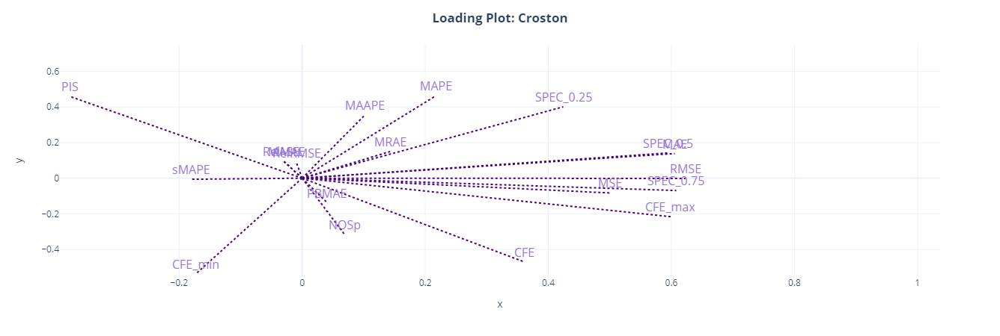

In [35]:
biplot(croston_item_metrics, features=['CFE',
       'CFE_min', 'CFE_max', 'NOSp', 'PIS', 'MSE', 'RMSE', 'MAE', 'MRAE',
       'MASE', 'MAPE', 'RelMAE', 'RelRMSE', 'PBMAE',
       'MAAPE', 'sMAPE', 'SPEC_0.75',"SPEC_0.5","SPEC_0.25"], title="<b>Loading Plot: Croston</b>")

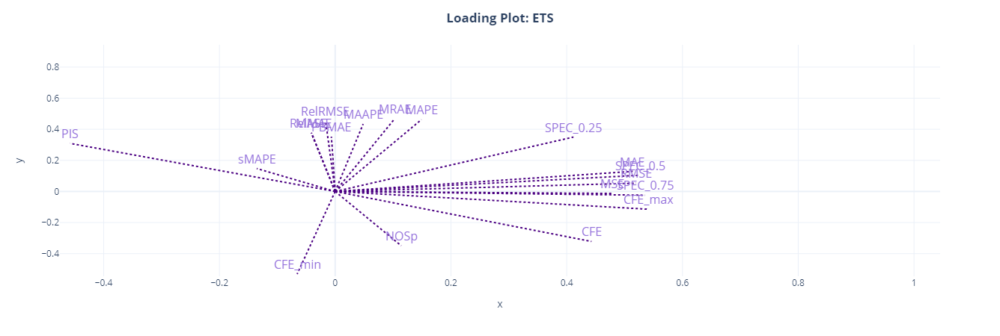

In [36]:
biplot(ets_item_metrics, features=['CFE',
       'CFE_min', 'CFE_max', 'NOSp', 'PIS', 'MSE', 'RMSE', 'MAE', 'MRAE',
       'MASE', 'MAPE', 'RelMAE', 'RelRMSE', 'PBMAE',
       'MAAPE', 'sMAPE', 'SPEC_0.75',"SPEC_0.5","SPEC_0.25"], title="<b>Loading Plot: ETS</b>")

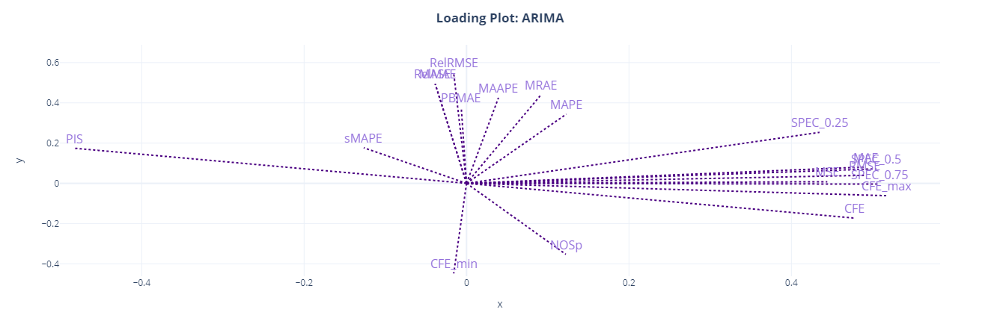

In [37]:
biplot(arima_item_metrics, features=['CFE',
       'CFE_min', 'CFE_max', 'NOSp', 'PIS', 'MSE', 'RMSE', 'MAE', 'MRAE',
       'MASE', 'MAPE', 'RelMAE', 'RelRMSE', 'PBMAE',
       'MAAPE', 'sMAPE', 'SPEC_0.75',"SPEC_0.5","SPEC_0.25"], title="<b>Loading Plot: ARIMA</b>")